## Perform Diffusion Component Analysis After R310 Downsampling <a class="tocSkip">

Downsample R310 patient cells and perform DC mapping to examine shifts in phenotype state associated with clinical outcomes, marker genes, or T cell process signatures.

Author: Kevin Hoffer-Hawlik

## Setup

In [2]:
# uncomment for interactive 3D plots
# %matplotlib notebook

import warnings
import pandas as pd
import numpy as np
import anndata as ad
import scanpy as sc
import matplotlib.pyplot as plt
import scvi
import seaborn as sns
import scipy.stats
import scib
import pickle
import seaborn as sns
import PyQt5

Global seed set to 0
/home/kh3205/anaconda3/envs/scvi-scib/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/home/kh3205/anaconda3/envs/scvi-scib/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


In [3]:
warnings.simplefilter(action='ignore',)

In [4]:
warnings.simplefilter(action='ignore',)

In [5]:
sc.settings.figdir = 'fig1'
sc.set_figure_params(figsize = (12,8), dpi_save = 200, format = 'png', transparent = True)

## Load data

In [6]:
tcells_filepath = 'tcells_scvi_annotated_041023.h5ad'
marker_genes_filepath = 'marker_genes_dict_030823.pickle'

tcells = sc.read_h5ad(tcells_filepath)

with open(marker_genes_filepath, 'rb') as handle:
    marker_genes = pickle.load(handle)

In [7]:
signatures = ["activation_markers_z_score_scvi_normalized",
              "exhaustion_markers_z_score_scvi_normalized",
              "CD8_T_cell_activation_z_score_scvi_normalized",
              "Type_II_interferon_response_z_score_scvi_normalized",
              "Exhaustion/Terminal_differentiation_z_score_scvi_normalized",
              "CD8_TIL_dysfunction_z_score_scvi_normalized",
              "T_cell_co-inhibitory_receptors_z_score_scvi_normalized",
              "naive_markers_z_score_scvi_normalized",
              "effector_cytokines_z_score_scvi_normalized",
              
              "Terminal_exhaustion_z_score_scvi_normalized", 
              "Precursor_exhaustion_z_score_scvi_normalized", 
              "T_naive_z_score_scvi_normalized", 
              "T_stem_central_memory_z_score_scvi_normalized", 
              "T_central_memory_z_score_scvi_normalized", 
              "T_effector_memory_z_score_scvi_normalized", 
              "T_terminal_effector_z_score_scvi_normalized", 
             ]

full_signatures = [s + '_z_score_scvi_normalized' for s in list(marker_genes.keys())[1:]]

In [7]:
cd8_cd4_sigs = ['CD2','ITGAE','CD69','CD137']

## Perform downsampling of R310 patient

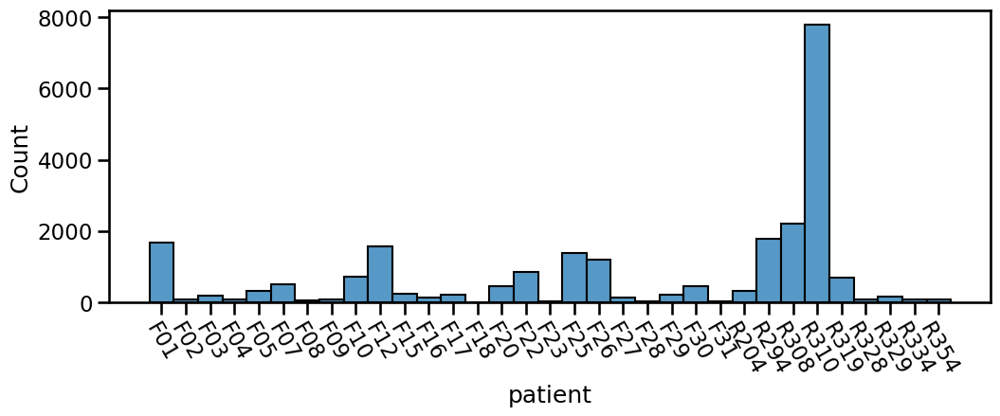

In [9]:
plt.figure(figsize=(12,4))
plt.xticks(rotation=300)
sns.histplot(tcells.obs, x='patient',);

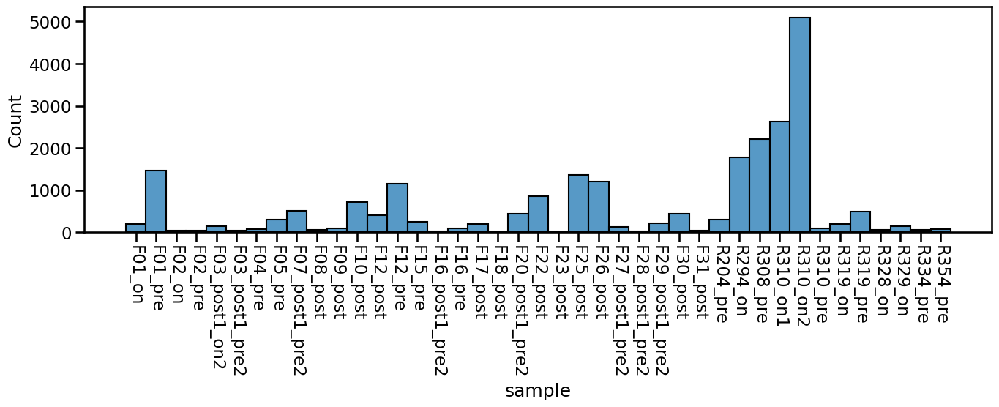

In [10]:
plt.figure(figsize=(16,4))
plt.xticks(rotation=270)
sns.histplot(tcells.obs, x='sample',);

In [21]:
print(tcells.obs[tcells.obs['sample']=='R310_on1'].shape[0])
print(tcells.obs[tcells.obs['sample']=='R310_on2'].shape[0])
print(tcells.obs[tcells.obs['sample']=='R308_pre'].shape[0])
final_R310_on_number = 2208 # split so total number of cells from R310 matches next highest (R308)

2624
5092
2208


In [23]:
tcells_R310_on1 = tcells[tcells.obs['sample']=='R310_on1',:]
tcells_R310_on2 = tcells[tcells.obs['sample']=='R310_on2',:]
tcells_other = tcells[~tcells.obs['sample'].isin(['R310_on1','R310_on2']),:]
print(tcells_R310_on1.shape)
print(tcells_R310_on2.shape)
print(tcells_other.shape)

(2624, 8170)
(5092, 8170)
(15942, 8170)


In [38]:
sc.pp.subsample(tcells_R310_on1, n_obs = final_R310_on_number//2)
sc.pp.subsample(tcells_R310_on2, n_obs = final_R310_on_number//2)
print(tcells_R310_on1.shape)
print(tcells_R310_on2.shape)

(1104, 8170)
(1104, 8170)


In [39]:
tcells_downsampled = ad.concat([tcells_R310_on1, tcells_R310_on2, tcells_other], axis=0)
tcells_downsampled.obs.shape

(18150, 553)

### Filter for only CD8 and CD4 cells

In [7]:
cd8_downsampled = tcells_downsampled[tcells_downsampled.obs.cell_type_khh.isin(['CD8+ T', 'Naive CD8+ T'])]
cd4_downsampled = tcells_downsampled[tcells_downsampled.obs.cell_type_khh.isin(['CD4+ T', 'Naive CD4+ T', 'Treg', 'naive Treg'])]
print(cd8_downsampled.shape)
print(cd4_downsampled.shape)

NameError: name 'tcells_downsampled' is not defined

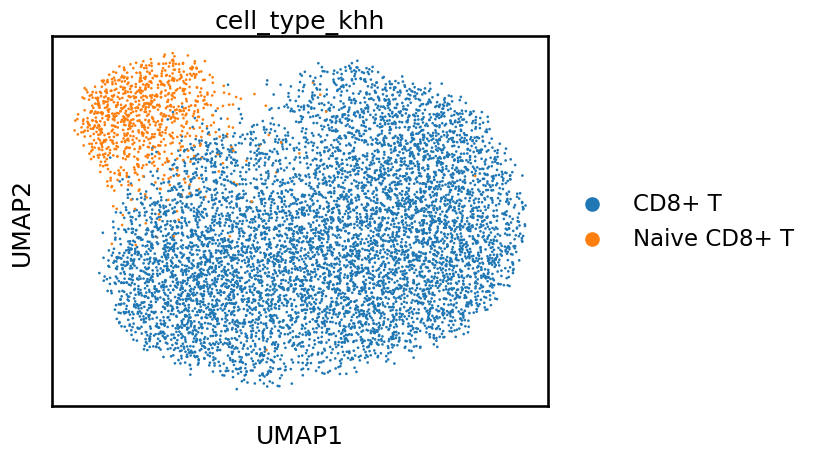

In [41]:
# calculate new neighborhood graph and UMAP dim reduction
sc.pp.neighbors(cd8_downsampled, use_rep="X_scVI", n_neighbors = 60, method = 'gauss')
sc.tl.umap(cd8_downsampled)
sc.pl.umap(cd8_downsampled, color=['cell_type_khh'])

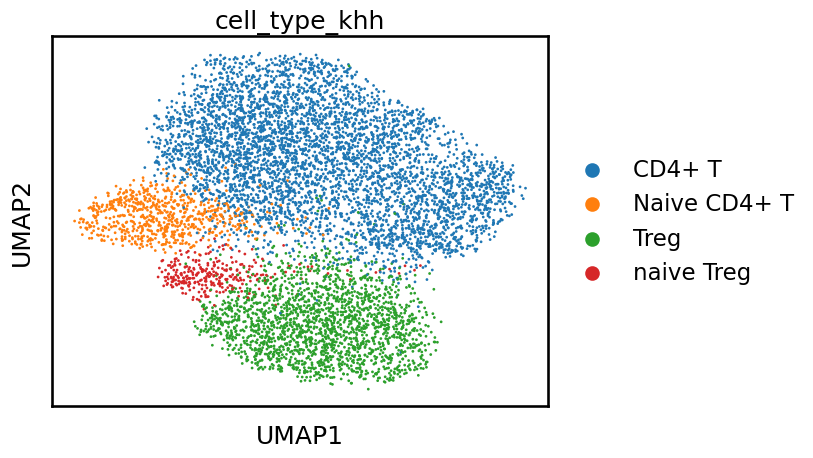

In [42]:
sc.pp.neighbors(cd4_downsampled, use_rep="X_scVI", n_neighbors = 20, method = 'gauss')
sc.tl.umap(cd4_downsampled)
sc.pl.umap(cd4_downsampled, color=['cell_type_khh'])

## Run diffusion components (CD8+ only)

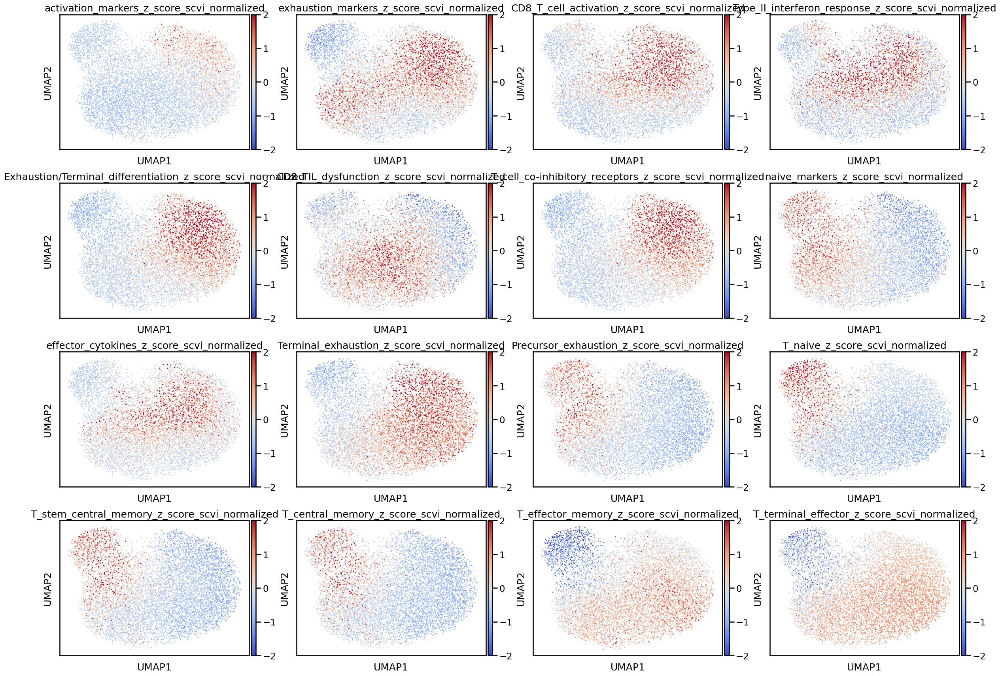

In [43]:
sc.pl.umap(cd8_downsampled, color = signatures, ncols = 4, vmin = -2, vmax = 2, cmap = 'coolwarm')

In [ ]:
# optimize sigma for diffusion maps (implicitly determined by N neighbors)
for neighbors in [20, 60, 120, 180, 240, 300]: # increase neighbors; use gaussian kernel for neighbors
    print('neighbors =', neighbors)
    sc.pp.neighbors(cd8_downsampled, use_rep="X_scVI", n_neighbors = neighbors, method = 'gauss')
    sc.tl.diffmap(cd8_downsampled) # calculate diffusion map
    for i in range(cd8_downsampled.obsm['X_diffmap'].shape[1]):
        cd8_downsampled.obs['DC' + str(i+1)] = cd8_downsampled.obsm['X_diffmap'][:,i]
    sc.pl.umap(cd8_downsampled, ncols = 5, # plot diffusion components
           color = ['DC' + str(i+1) for i in range(cd8_downsampled.obsm['X_diffmap'].shape[1])])

In [ ]:
# create final new neighborhood graph
sc.pp.neighbors(cd8_downsampled, use_rep="X_scVI", n_neighbors = 60, method = 'gauss') 
sc.tl.diffmap(cd8_downsampled)
for i in range(cd8_downsampled.obsm['X_diffmap'].shape[1]):
    cd8_downsampled.obs['DC' + str(i+1)] = cd8_downsampled.obsm['X_diffmap'][:,i]

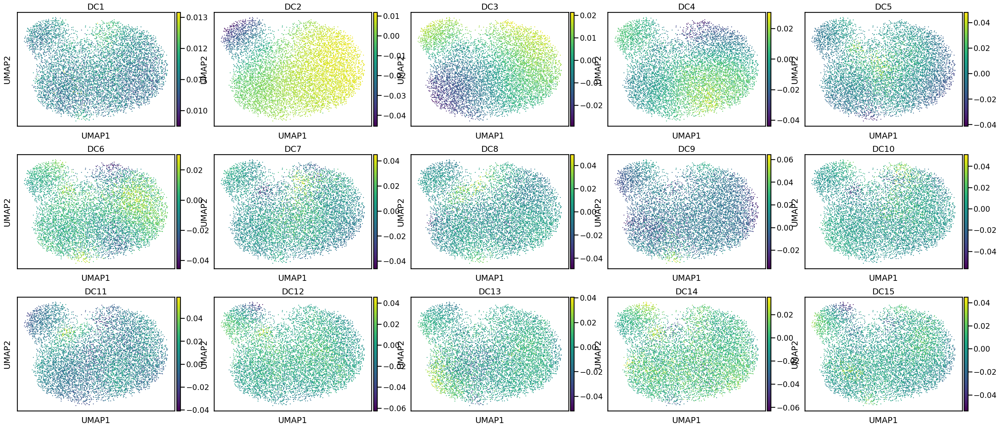

In [45]:
sc.pl.umap(cd8_downsampled, ncols = 5,
           color = ['DC' + str(i+1) for i in range(cd8_downsampled.obsm['X_diffmap'].shape[1])])

In [46]:
cd8_downsampled.write('cd8_downsampled_051723.h5ad')

### Visualize genes and signatures in DC space (CD8+)

In [8]:
cd8_downsampled = sc.read_h5ad('cd8_downsampled_051723.h5ad')

# to randomize DC maps
np.random.seed(0)
random_indices=np.random.permutation(list(range(cd8_downsampled.shape[0])))

In [9]:
# choose DC components for further analysis
dc1_cd8 = 1 # 'DC2'
dc2_cd8 = 2 # 'DC3'
dc3_cd8 = 3 # 'DC4'

def cd8_diffmap_obs(obs, ad=cd8_downsampled, vmin=None, vmax=None, ncols=3, cmap=None, s = .1, title = None,
                    elev=40, azim=8):
    axes = sc.pl.diffmap(ad[random_indices,:], dimensions=(dc1_cd8,dc2_cd8,dc3_cd8), projection='3d', color = obs, 
                         show = False, title = title, vmin = vmin, vmax = vmax, ncols = ncols, cmap=cmap, size = s)
    try:
        for ax in axes:
            ax.view_init(elev=elev, azim=azim, roll=0)
    except TypeError:
        axes.view_init(elev=elev, azim=azim, roll=0)

def cd8_diffmap_gene(genes, ad=cd8_downsampled, vmin=None, vmax=None, layer='scvi_normalized', ncols=3, cmap=None,
                     elev=40, azim=8):
    sc.set_figure_params(figsize = (12,8))
    axes = sc.pl.diffmap(ad[random_indices,:], dimensions=(dc1_cd8,dc2_cd8,dc3_cd8), projection='3d', color = genes, 
                         show = False, vmin = vmin, vmax = vmax, layer = layer, ncols = ncols, cmap=cmap)
    try:
        for ax in axes:
            ax.view_init(elev=elev, azim=azim, roll=0)
    except TypeError:
        axes.view_init(elev=elev, azim=azim, roll=0)
        
def randomized_dc(ad, obs, vmin = None, vmax = None, cmap = None, elev = 40, azim = 8):
    rand=np.random.permutation(list(range(ad.shape[0])))
    fig = plt.figure(figsize = (12,8))
    ax = fig.add_subplot(projection='3d')
    # print(ad[rand,:].obs['DC3']) # check for randomization
    scatter = ax.scatter(ad[rand,:].obs['DC2'],
                 ad[rand,:].obs['DC3'],
                 ad[rand,:].obs['DC4'],
                 c = ad[rand,:].obs[obs],
                 vmin = vmin, vmax = vmax, cmap = cmap, s = 2)
    ax.grid(False)
    ax.set_xlabel('DC2')
    # ax.set_xticks([])
    ax.set_ylabel('DC3')
    # ax.set_yticks([])
    ax.set_zlabel('DC4')
    ax.set_title(obs)
    # ax.set_zticks([])
    ax.view_init(elev = elev, azim = azim)
    fig.colorbar(scatter)
    fig.show()

In [10]:
cd8_downsampled_cleaned = cd8_downsampled.copy()
cd8_downsampled_cleaned.obs = cd8_downsampled_cleaned.obs.loc[:,full_signatures]
cd8_downsampled_cleaned.obs.columns = [s for s in list(marker_genes.keys())[1:]]

# cd8_diffmap_obs([s[0:-24] for s in signatures], ad=cd8_downsampled_cleaned, vmin=-2, vmax=2, ncols=4, cmap='coolwarm')

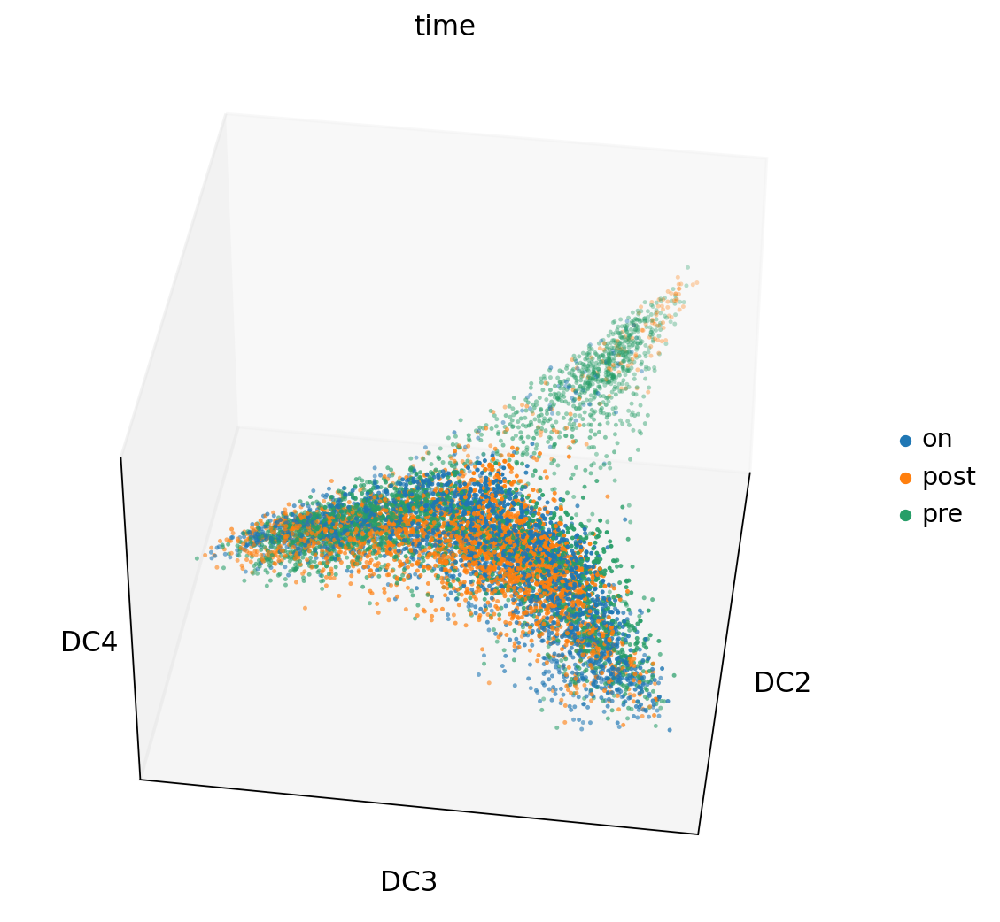

In [11]:
elev2 = 50
azim2 = -160

# cd8_diffmap_obs('cell_type_khh', elev=elev2, azim=azim2)
# cd8_diffmap_obs('patient')
# cd8_diffmap_obs('sample')
cd8_diffmap_obs('time')
# cd8_diffmap_obs('tissue')
# cd8_diffmap_obs('cohort')
# cd8_diffmap_obs('Drug')
# cd8_diffmap_obs('clone_size', )#elev=0, azim=0)
# cd8_diffmap_obs('mait_inkt')
# cd8_diffmap_obs('days_to/from_ICI_start', vmin= -40, vmax= 400)
# cd8_diffmap_obs('treatment_duration', vmax = 700)
# cd8_diffmap_obs('survival_status')
# cd8_diffmap_obs('OS', vmax = 1000)

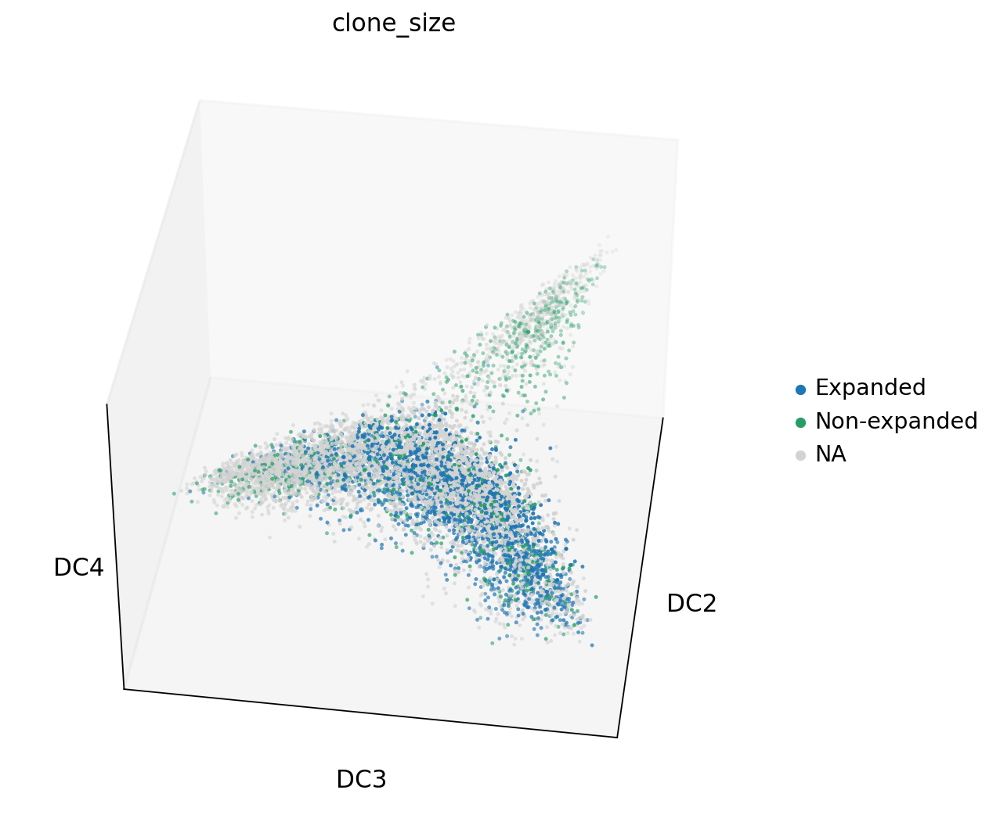

In [12]:
axes = sc.pl.diffmap(cd8_downsampled, projection = '3d',  dimensions=(dc1_cd8,dc2_cd8,dc3_cd8), 
              color = 'clone_size', groups = ['Expanded', 'Non-expanded'], show = False) # make grey transparent
axes.view_init(elev=40, azim=8, roll=0)

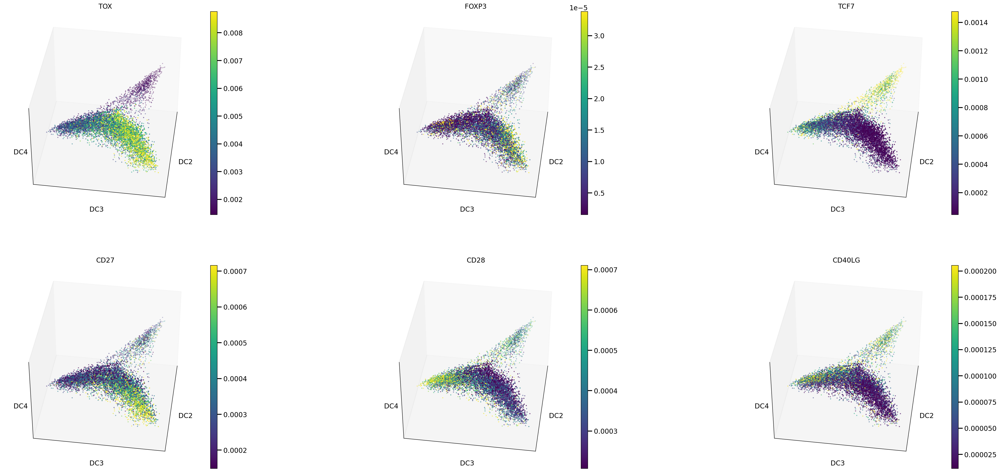

In [25]:
other_genes_of_interest = ["TOX", "FOXP3", "TCF7", "CD8A", "CD8B", "CD4", "CD3E", "NCAM1",
                           "TIGIT", "PDCD1", "CD274", "CTLA4", "LAG3", "HAVCR2", "CD244", "CD160", 'CD28', 'CD27',
                           # PDCD1 = PD-1, CD274 = PD-L1, HAVCR2 = TIM3
                           'IL2RA', 'IFNG', 'CD40LG', 'TNFRSF4', 'TNFRSF18', 'CCL5', 'CXCL5','GZMB', 'GZMH', 'ZNF683',
                           'PRF1', 'GZMK', 'ITGAE', 'CXCL13', 'CCR7', 'IL7R', 'MKI67', 'GINS2']

cd8_diffmap_gene(['TOX','FOXP3','TCF7','CD27','CD28','CD40LG'], vmin = 'p10', vmax = 'p90', ncols=3)

In [102]:
# display all signatures
# cd8_diffmap_obs(list(marker_genes.keys())[1:], ad=cd8_downsampled_cleaned, vmin=-2, vmax=2, ncols=5, cmap='coolwarm')

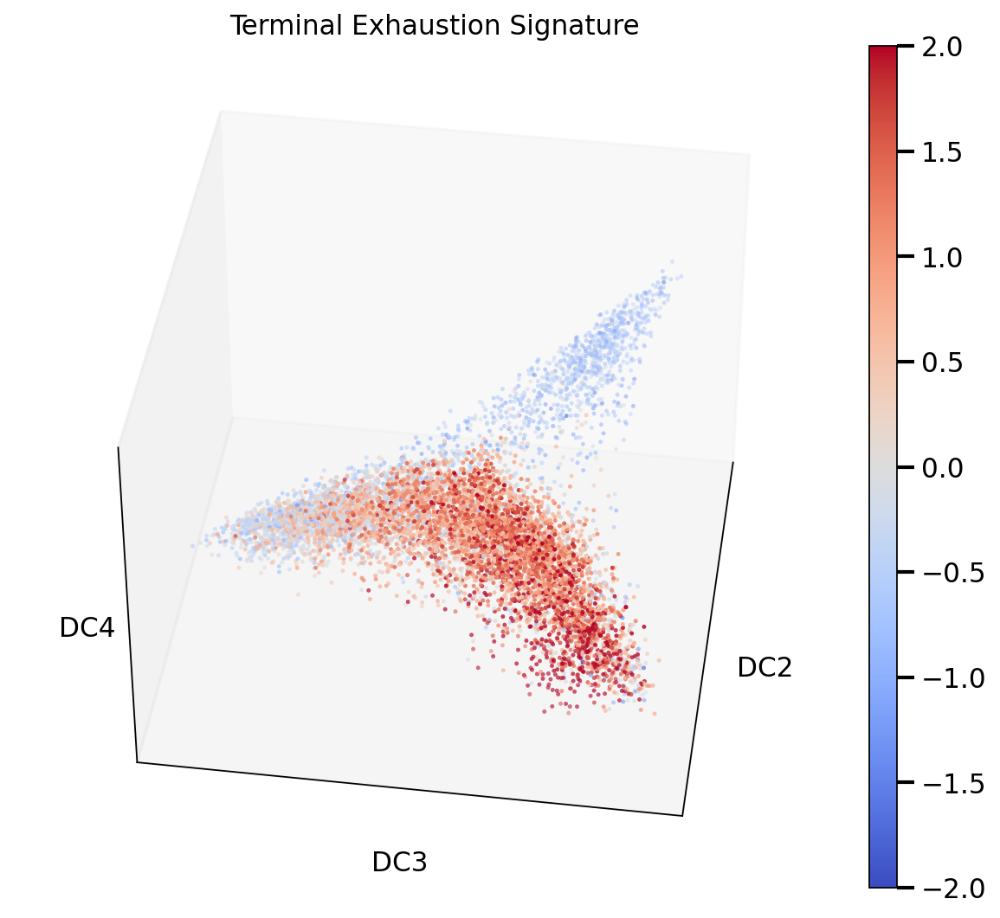

In [19]:
cd8_diffmap_obs('Terminal_exhaustion', title = 'Terminal Exhaustion Signature', 
                ad=cd8_downsampled_cleaned, vmin=-2, vmax=2, cmap='coolwarm')

### Examine distributions along DCs

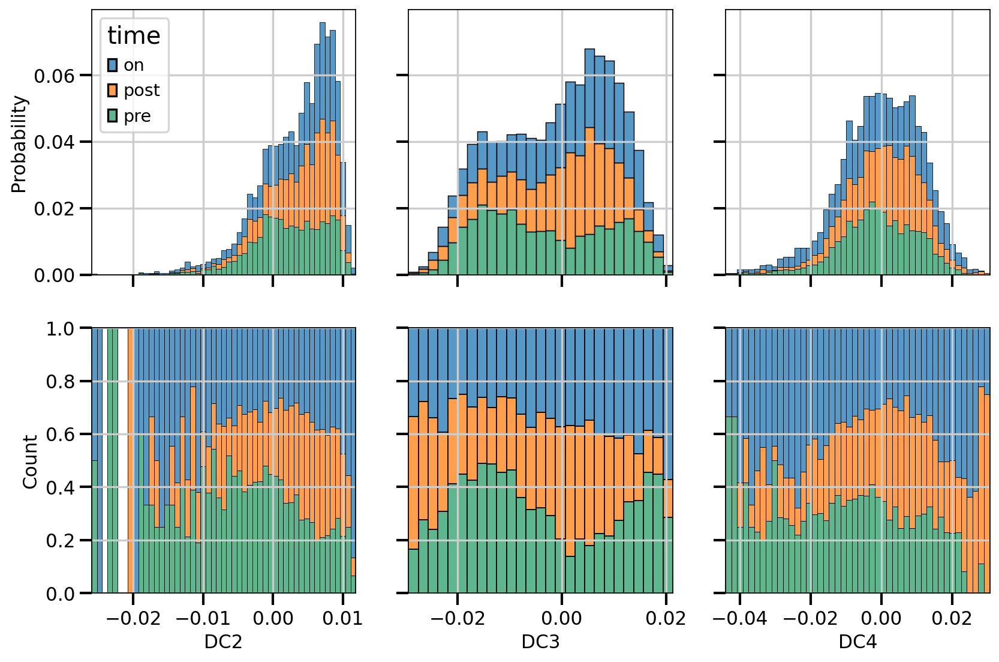

In [58]:
df = cd8_downsampled.obs.loc[df.cell_type_khh != 'Naive CD8+ T',:]
obs = 'time'
fig, ((ax1,ax2,ax3),(ax4,ax5,ax6)) = plt.subplots(2,3, sharex = 'col', sharey = 'row')

sns.histplot(data = df, x = 'DC2', hue = obs, multiple='stack', stat = 'probability', ax = ax1) # probability across each category
sns.histplot(data = df, x = 'DC3', hue = obs, multiple='stack', stat = 'probability', ax = ax2, legend = False)
sns.histplot(data = df, x = 'DC4', hue = obs, multiple='stack', stat = 'probability', ax = ax3, legend = False)
sns.histplot(data = df, x = 'DC2', hue = obs, multiple='fill', ax = ax4, legend = False)
sns.histplot(data = df, x = 'DC3', hue = obs, multiple='fill', ax = ax5, legend = False)
sns.histplot(data = df, x = 'DC4', hue = obs, multiple='fill', ax = ax6, legend = False);

<AxesSubplot: xlabel='DC4', ylabel='Probability'>

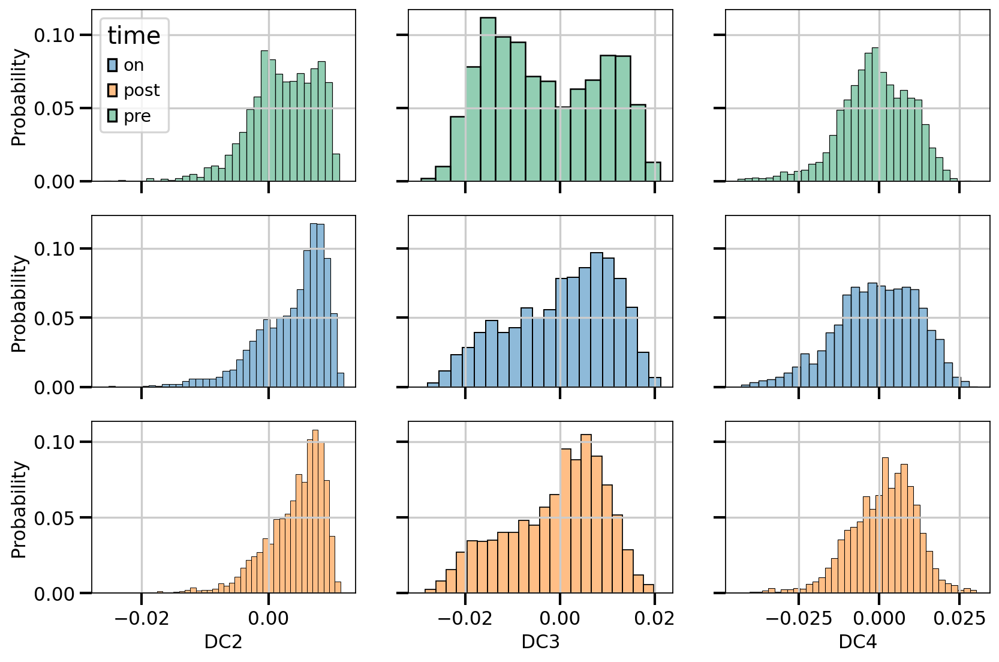

In [ ]:
# df = df.loc[df.cell_type_khh != 'Naive CD8+ T',:]
obs = 'time'
fig, ((ax1,ax2,ax3),(ax4,ax5,ax6), (ax7,ax8,ax9)) = plt.subplots(3,3, sharex = 'col', sharey = 'row')

sns.histplot(data = df.loc[df.time == 'pre',:], x = 'DC2', hue = 'time', stat = 'probability', ax = ax1) 
sns.histplot(data = df.loc[df.time == 'pre',:], x = 'DC3', hue = 'time', stat = 'probability', ax = ax2, legend = False)
sns.histplot(data = df.loc[df.time == 'pre',:], x = 'DC4', hue = 'time', stat = 'probability', ax = ax3, legend = False)

sns.histplot(data = df.loc[df.time == 'on',:], x = 'DC2', hue = 'time', stat = 'probability', ax = ax4, legend = False) 
sns.histplot(data = df.loc[df.time == 'on',:], x = 'DC3', hue = 'time', stat = 'probability', ax = ax5, legend = False)
sns.histplot(data = df.loc[df.time == 'on',:], x = 'DC4', hue = 'time', stat = 'probability', ax = ax6, legend = False)

sns.histplot(data = df.loc[df.time == 'post',:], x = 'DC2', hue = 'time', stat = 'probability', ax = ax7, legend = False) 
sns.histplot(data = df.loc[df.time == 'post',:], x = 'DC3', hue = 'time', stat = 'probability', ax = ax8, legend = False)
sns.histplot(data = df.loc[df.time == 'post',:], x = 'DC4', hue = 'time', stat = 'probability', ax = ax9, legend = False)


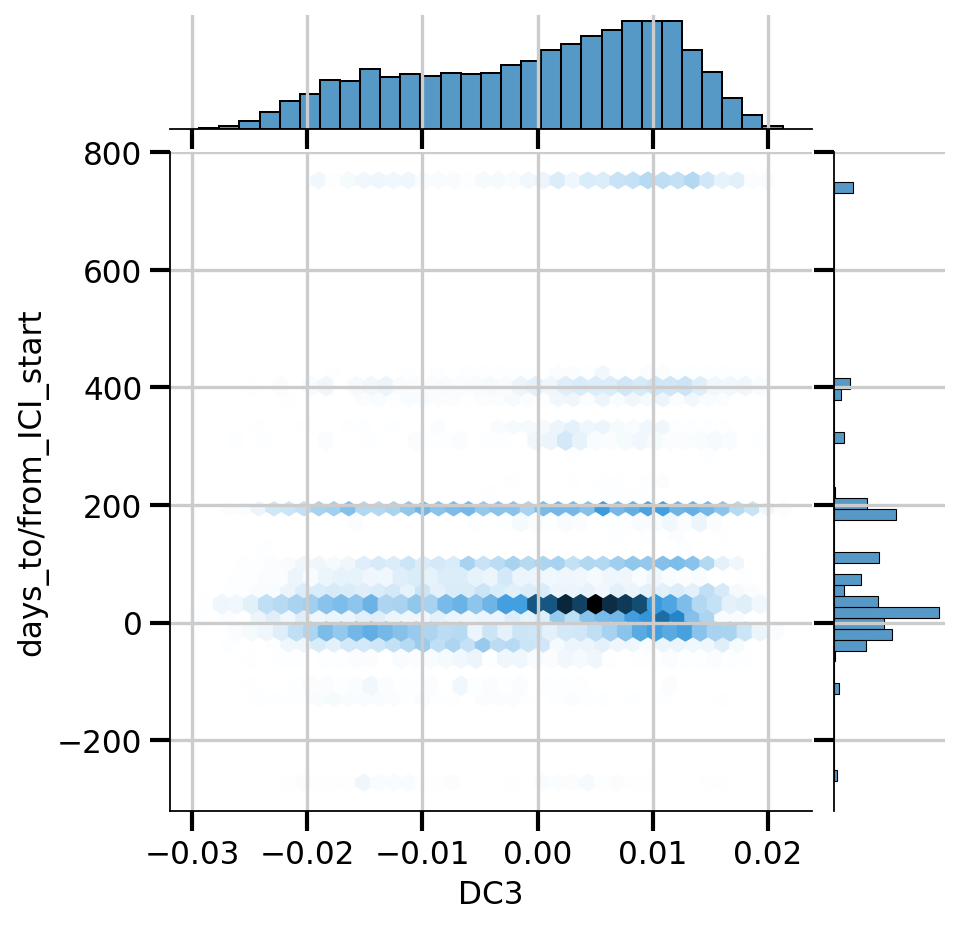

In [15]:
sns.jointplot(data = df, x = 'DC3', y = 'days_to/from_ICI_start', kind = 'hex')
sns.jointplot(data = df, x = 'DC3', y = 'days_to/from_ICI_start', kind = 'hex')
# sns.histplot(data = df, x = 'DC4', hue = obs, multiple='stack', ax = ax3)

### Calculate pseudotime trajectory

In [ ]:
# set root cell
cd8_downsampled.uns['iroot'] = np.flatnonzero(cd8_downsampled.obs['cell_type_khh'] == 'Naive CD8+ T')[0]

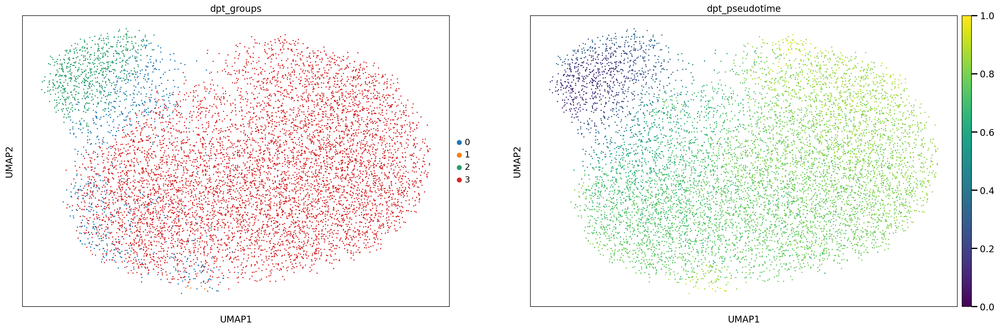

In [12]:
sc.tl.dpt(cd8_downsampled, n_branchings = 1)
sc.pl.umap(cd8_downsampled, color = ['dpt_groups','dpt_pseudotime'])

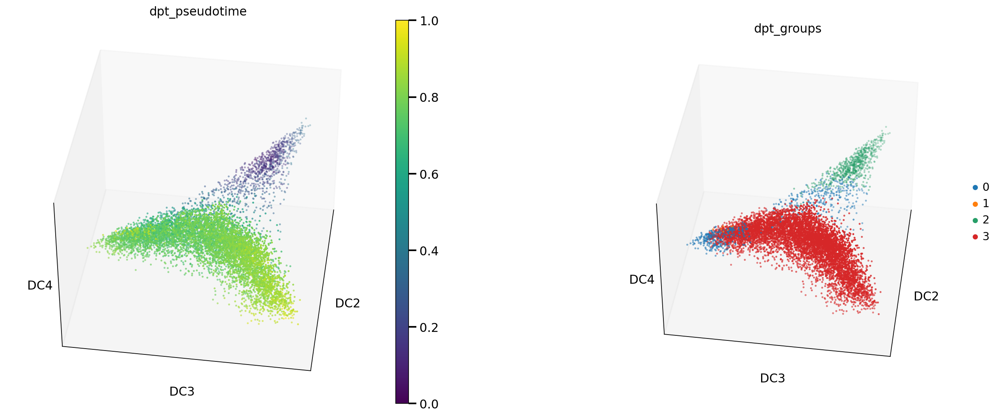

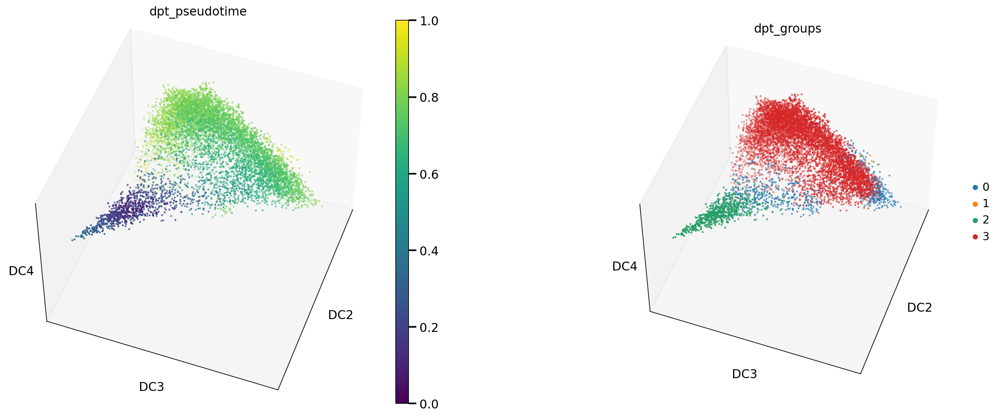

In [256]:
cd8_diffmap_obs(['dpt_pseudotime','dpt_groups'])
cd8_diffmap_obs(['dpt_pseudotime','dpt_groups'], elev = elev2, azim = azim2)

<AxesSubplot: xlabel='dpt_pseudotime', ylabel='Count'>

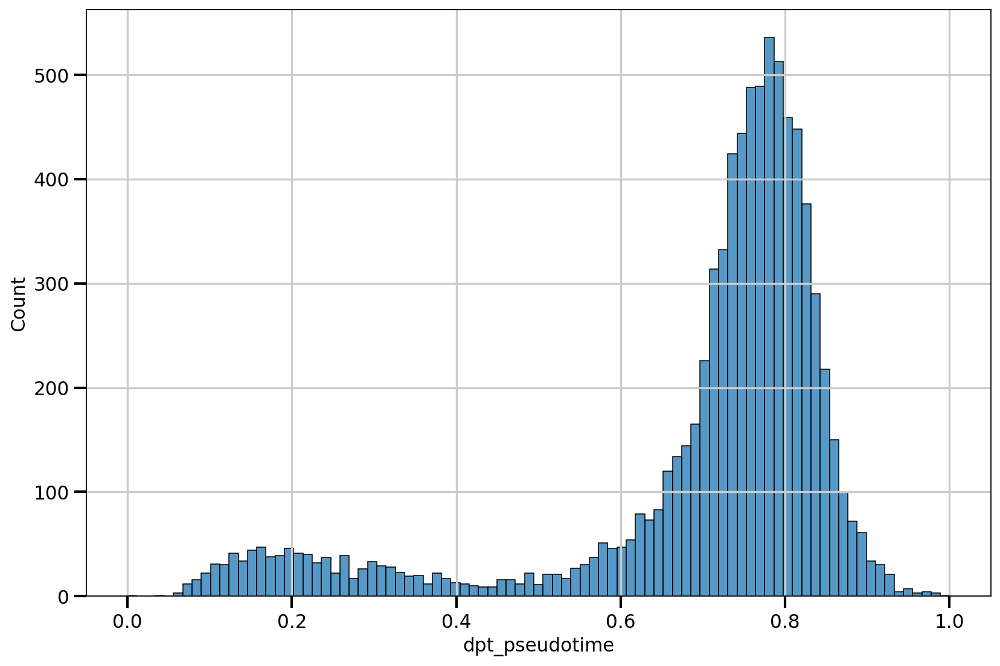

In [16]:
sns.histplot(cd8_downsampled.obs, x = 'dpt_pseudotime')

## Compute DCs for CD4+ T cells

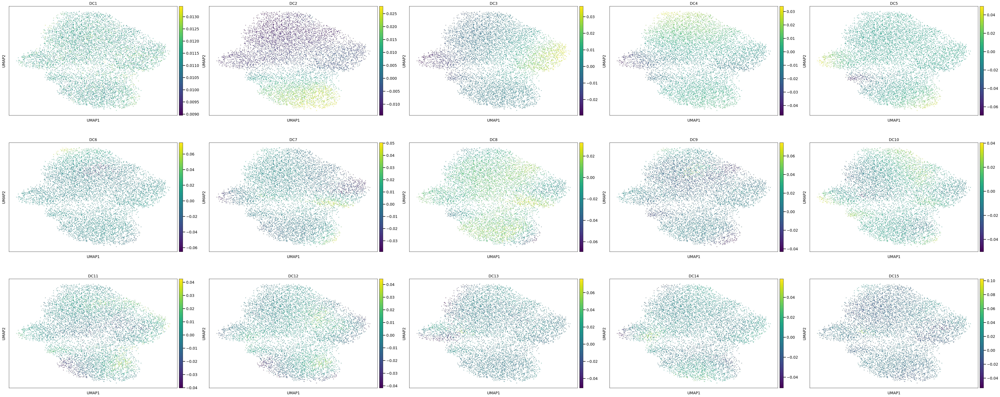

In [26]:
# create final new neighborhood graph
sc.pp.neighbors(cd4_downsampled, use_rep="X_scVI", n_neighbors = 20, method = 'gauss') 
sc.tl.diffmap(cd4_downsampled)
for i in range(cd4_downsampled.obsm['X_diffmap'].shape[1]):
    cd4_downsampled.obs['DC' + str(i+1)] = cd4_downsampled.obsm['X_diffmap'][:,i]

sc.pl.umap(cd4_downsampled, ncols = 5,
           color = ['DC' + str(i+1) for i in range(cd4_downsampled.obsm['X_diffmap'].shape[1])])

In [194]:
cd4_downsampled.write('cd4_downsampled_052223.h5ad')

In [20]:
cd4_downsampled = sc.read_h5ad('cd4_downsampled_052223.h5ad')

# to randomize DC maps
np.random.seed(0)
random_indices_cd4=np.random.permutation(list(range(cd4_downsampled.shape[0])))

In [ ]:
# choose DC components for further analysis
dc1_cd4 = 1 # 'DC2'
dc2_cd4 = 2 # 'DC3'
dc3_cd4 = 3 # 'DC4'

def cd4_diffmap_obs(obs, ad=cd4_downsampled, vmin=None, vmax=None, ncols=3, cmap=None, s = .1, elev=40, azim=8):
    axes = sc.pl.diffmap(ad[random_indices_cd4,:], dimensions=(dc1_cd4,dc2_cd4,dc3_cd4), projection='3d', color = obs, 
                         show = False, vmin = vmin, vmax = vmax, ncols = ncols, cmap=cmap, size = s)
    try:
        for ax in axes:
            ax.view_init(elev=elev, azim=azim, roll=0)
    except TypeError:
        axes.view_init(elev=elev, azim=azim, roll=0)
        
def randomized_dc(ad, obs, vmin = None, vmax = None, cmap = None, elev = 40, azim = 8):
    rand=np.random.permutation(list(range(ad.shape[0])))
    fig = plt.figure(figsize = (12,8))
    ax = fig.add_subplot(projection='3d')
    # print(ad[rand,:].obs['DC3']) # check for randomization
    scatter = ax.scatter(ad[rand,:].obs['DC2'],
                 ad[rand,:].obs['DC3'],
                 ad[rand,:].obs['DC4'],
                 c = ad[rand,:].obs[obs],
                 vmin = vmin, vmax = vmax, cmap = cmap, s = 2)
    ax.grid(False)
    ax.set_xlabel('DC2')
    # ax.set_xticks([])
    ax.set_ylabel('DC3')
    # ax.set_yticks([])
    ax.set_zlabel('DC4')
    ax.set_title(obs)
    # ax.set_zticks([])
    ax.view_init(elev = elev, azim = azim)
    fig.colorbar(scatter)
    fig.show()

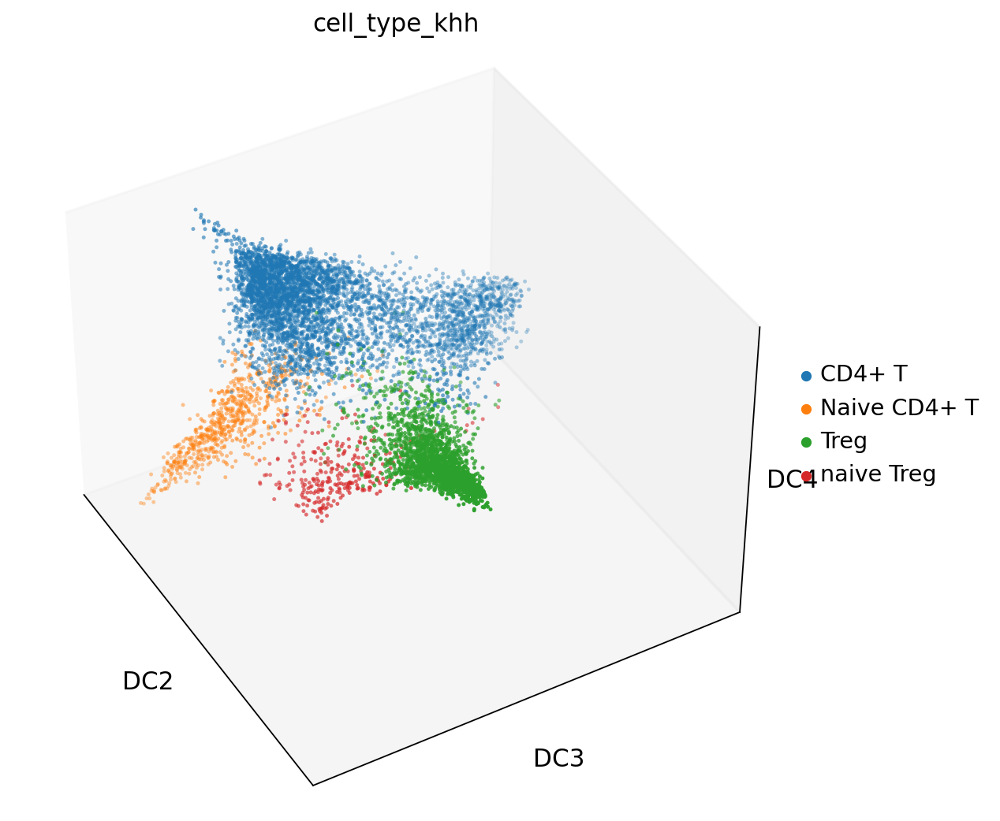

In [51]:
cd4_diffmap_obs('cell_type_khh', elev = 40, azim = -30)

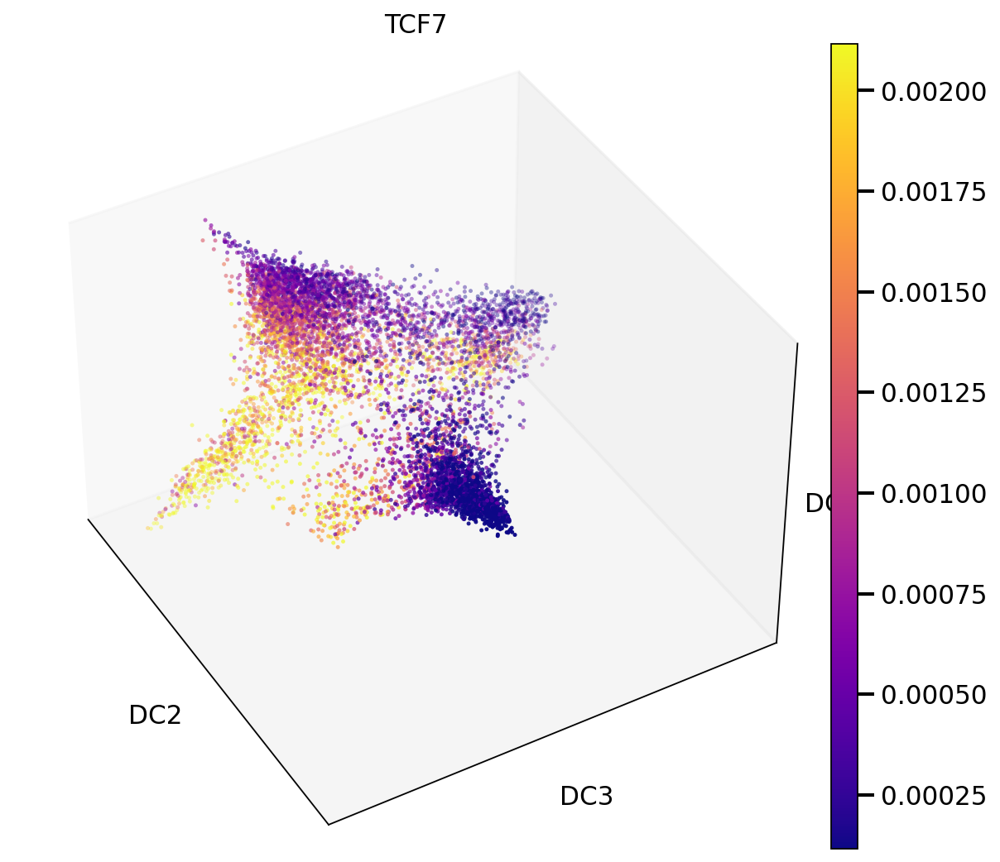

In [52]:
axes = sc.pl.diffmap(cd4_downsampled[random_indices_cd4,:], dimensions=(dc1_cd4,dc2_cd4,dc3_cd4), projection='3d', color = 'TCF7', 
                         show = False, vmin = 'p10', vmax = 'p90', cmap = 'plasma', size = .1, layer = 'scvi_normalized')
axes.view_init(elev=40, azim=-30, roll=0)

### Calculate pseudotime

In [31]:
# set root cell
cd4_downsampled.uns['iroot'] = np.argmin(cd4_downsampled.obs['DC3']) # choose naive cell at beginning of DC3 axis
sc.tl.dpt(cd4_downsampled, n_branchings = 3)

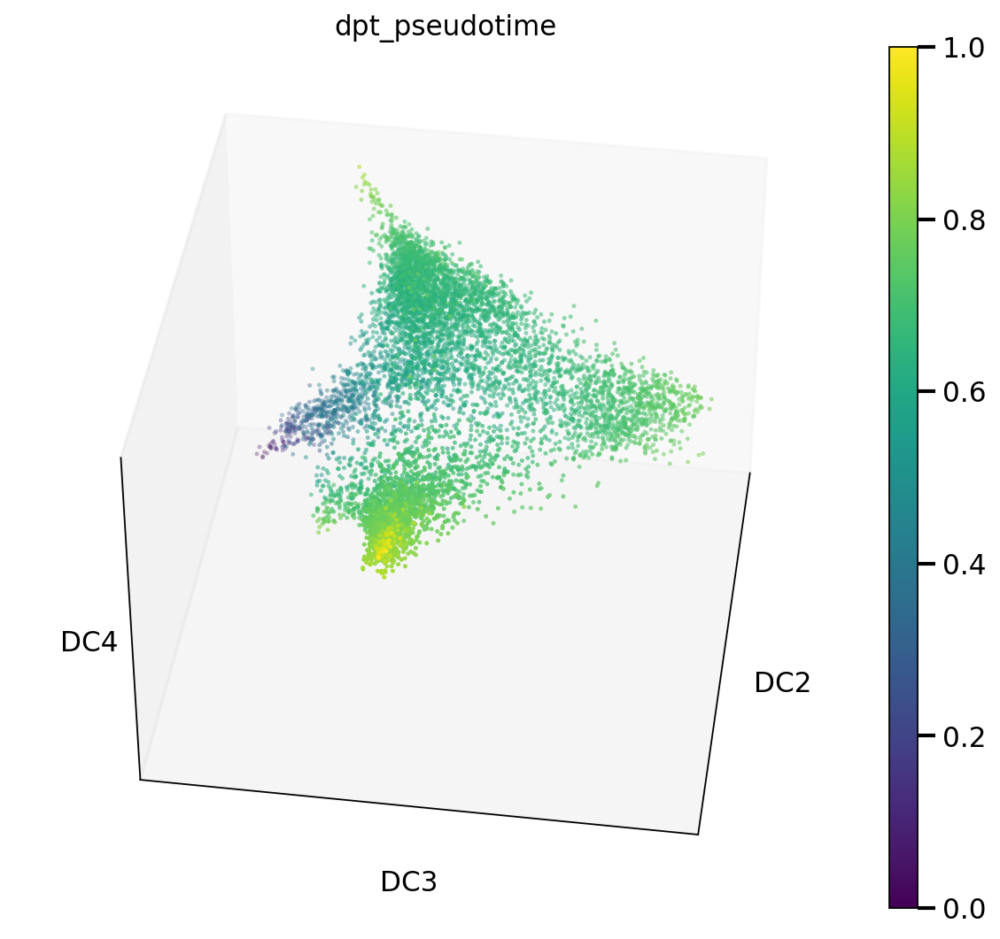

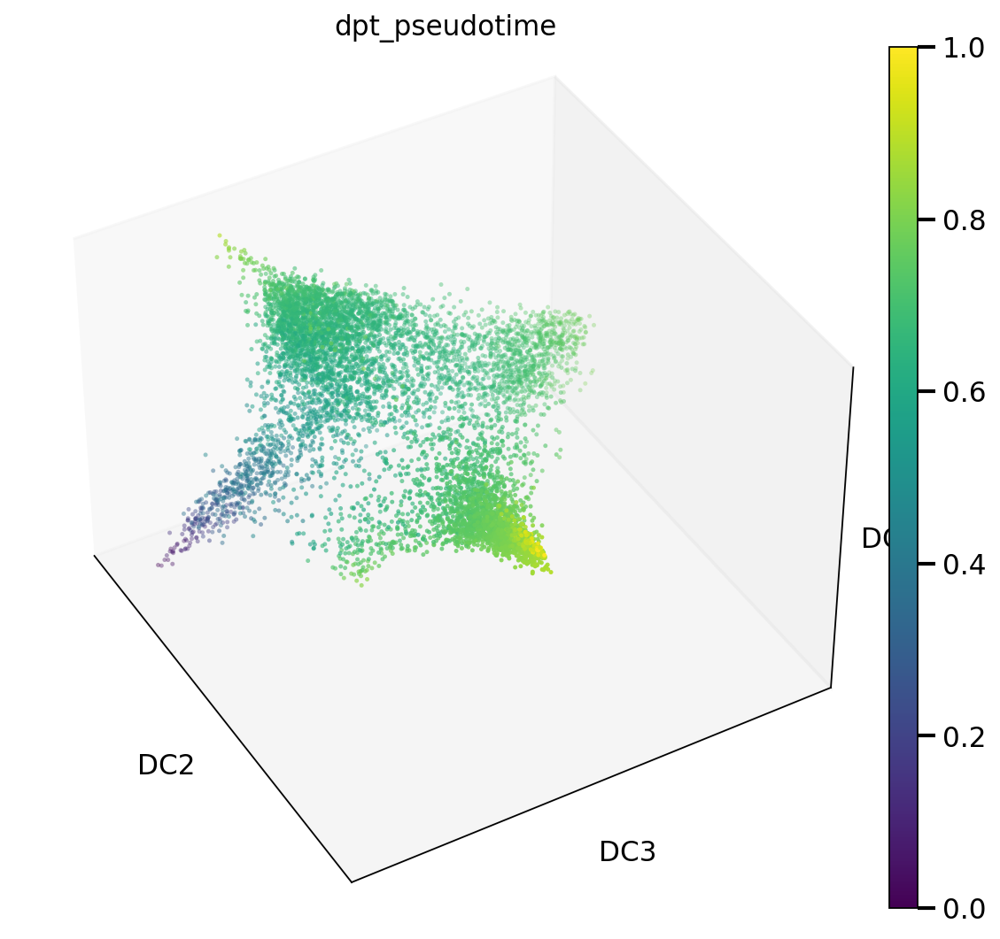

In [32]:
cd4_diffmap_obs('dpt_pseudotime')
cd4_diffmap_obs('dpt_pseudotime', elev=40, azim=-30)